In [14]:
from ssapp.data.AntennaDatasetLoaders import MLADataset1
from torch.utils.data.dataloader import DataLoader  
from ssapp.data.AntennaDatasetLoaders import load_serialized_dataset

%matplotlib inline
%config InlineBackend.figure_formats = ['svg']
%load_ext autoreload
%autoreload 2

dataset = load_serialized_dataset('MLADataset1_Train')

params, fields = next(iter(DataLoader(dataset, batch_size=len(dataset))))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


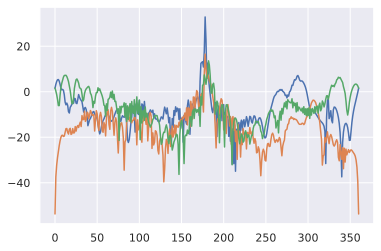

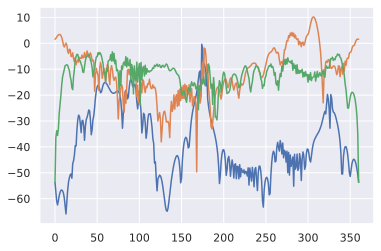

In [15]:
#print(params)
from matplotlib import pyplot as plt
import numpy as np
import plotly.express as pltexp

mag_co = lambda a,i: 20*np.log10(np.sqrt(a[i,:,:,0]**2+a[i,:,:,1]**2))
mag_cross = lambda a,i: 20*np.log10(np.sqrt(a[i,:,:,2]**2+a[i,:,:,3]**2))


plt.figure()
plt.plot(mag_co(fields,3000))
plt.figure()
plt.plot(mag_cross(fields,3000))

# Visualise Latent Space

In [18]:
from ssapp.visualization.PCA_Visualisation import plotParameterColoredLatentSpace
dataset_train = load_serialized_dataset('MLADataset1_Train')
plotParameterColoredLatentSpace(dataset,figsize=(12,11), layout_shape = (3,3),pca_components=(1,2))

IndexError: index 9 is out of bounds for axis 0 with size 9

In [19]:
from ssapp.visualization.PCA_Visualisation import plotParameterColoredLatentSpace
plotParameterColoredLatentSpace(dataset,figsize=(12,11), layout_shape = (3,3),pca_components=(3,4))

IndexError: index 9 is out of bounds for axis 0 with size 9

In [10]:

from ssapp.data.AntennaDatasetLoaders import load_serialized_dataset,train_test_dataloader_split
from torch.utils.data.dataloader import DataLoader
from ssapp.data.Metrics import relRMSE
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.gaussian_process.kernels import RBF, ConstantKernel,Matern



dataset_train = load_serialized_dataset('MLADataset1_Train')
dataset_val = load_serialized_dataset('MLADataset1_Val')

train_dataloader = DataLoader(dataset_train,batch_size = len(dataset_train))
val_dataloader = DataLoader(dataset_val,batch_size = len(dataset_val))


train_params, train_fields = next(iter(train_dataloader))
val_params, val_fields = next(iter(val_dataloader))

kernel = ConstantKernel(1.0, constant_value_bounds="fixed") * RBF(1.0, length_scale_bounds="fixed")

std_gp = Pipeline([('scaler', StandardScaler()), ('gp', GaussianProcessRegressor(kernel = kernel, normalize_y=True))])

def score(model,x,y):
    pred = model.predict(x)
    return relRMSE(y.reshape(len(y),-1),pred.reshape(len(pred),-1))


kernel = ConstantKernel(1.0, constant_value_bounds="fixed") * RBF(1, length_scale_bounds="fixed")

std_gp = Pipeline([('scaler', StandardScaler()), ('gp', GaussianProcessRegressor(kernel = kernel, normalize_y=True))])
std_gp.fit(train_params,train_fields.reshape(len(train_fields),-1))



Pipeline(steps=[('scaler', StandardScaler()),
                ('gp',
                 GaussianProcessRegressor(kernel=1**2 * RBF(length_scale=1),
                                          normalize_y=True))])

In [11]:
print(score(std_gp,train_params,train_fields))
print(score(std_gp,val_params,val_fields))

6.585241977027628e-11
0.6108339109419822
